# yolo v5
`v4에서 backbone을 EfficientNet으로 변경.`   
[EfficientNet paper](https://paperswithcode.com/method/efficientnet#:~:text=EfficientNet%20is%20a%20convolutional%20neural,resolution%20using%20a%20compound%20coefficient.)  
- a convolutional neural network architecture and scaling method  

`mAP는 비슷하나 더욱 가볍고 빠름. (pytorch로 구현, v4는 Darknet)`  
1. git clone
2. install requirements.txt
3. img 파일 다운로드
4. data.yaml 파일안에 img 파일 경로 넣기.

>from IPython.core.magic import register_line_cell_magic  
@register_line_cell_magic  
def write_template(file, txts):  
    with open(file, 'w') as f:  
>        f.write(txts.format(**globals()))

5. models.yolov5.yaml 파일 수정하기.
6. python train.py 실행
7. tensorboard 로 확인
8. python val.py 실행
9. python detect.py 실행
10. 결과 확인 및 best.pt 따로 보관!

- labels 폴더 안 건드리네.

In [174]:
!ls pothole pothole/train

pothole:
best.pt    README.dataset.txt	test	  train      valid
data.yaml  README.roboflow.txt	test.txt  train.txt  val.txt

pothole/train:
images	labels	labels.cache


In [ ]:
# https://minmiin.tistory.com/14
1. Annotation 파일들은 개별 이미지 파일과 같은 이름을 가져야 하고,
2. 이미지 폴더가 위치한 디렉토리 내의 /labels 폴더에 저장되어야 한다

root 디렉토리
ㄴ 이미지 폴더
ㄴ labels

In [ ]:
bounding box는 [x, y, w, h]
이미지 크기를 0-1로 Normalize했을 때의 값
0 0.6578125 0.475 0.3 0.10416666666666667
label = 0
x축 = 0.6578125
y축 = 0.475
width = 0.3
height = 0.10416666666666667

In [ ]:
# xml 2 txt -> yolo 형식으로 변환

# 경로를 지정해주자.

path = "./dataset"
annot_path = os.path.join(path,"annotations")
img_path = os.path.join(path,"images")
label_path = os.path.join(path,"labels")

import xml.etree.ElementTree as ET
import glob
import os
import json

# xml bbox 형식을 yolo bbox 형태로 변환하는 함수

def xml_to_yolo_bbox(bbox, w, h):
    # xmin, ymin, xmax, ymax
    x_center = ((bbox[2] + bbox[0]) / 2) / w
    y_center = ((bbox[3] + bbox[1]) / 2) / h
    width = (bbox[2] - bbox[0]) / w
    height = (bbox[3] - bbox[1]) / h
    return [x_center, y_center, width, height]

 classes = []

from tqdm import tqdm

files = glob.glob(os.path.join(annot_path, '*.xml'))
for fil in tqdm(files): #

    basename = os.path.basename(fil)
    filename = os.path.splitext(basename)[0]

    result = [] #

    tree = ET.parse(fil)
    root = tree.getroot()
    width = int(root.find("size").find("width").text)
    height = int(root.find("size").find("height").text)
    for obj in root.findall('object'):
        label = obj.find("name").text
        if label not in classes:
            classes.append(label)
        index = classes.index(label)
        pil_bbox = [int(x.text) for x in obj.find("bndbox")]
        yolo_bbox = xml_to_yolo_bbox(pil_bbox, width, height)
        bbox_string = " ".join([str(x) for x in yolo_bbox])
        result.append(f"{index} {bbox_string}") #
    if result: # 1개가 있다면 labels 폴더에 넣기!
        with open(os.path.join(label_path, f"{filename}.txt"), "w", encoding="utf-8") as f:
            f.write("\n".join(result))

In [ ]:
git clone https://github.com/ultralytics/yolov5  # clone
cd yolov5
pip install -r requirements.txt  # install

In [ ]:
python train.py --data coco.yaml --epochs 300 --weights '' --cfg yolov5n.yaml  --batch-size 128
                                                                 yolov5s                    64
                                                                 yolov5m                    40
                                                                 yolov5l                    24
                                                                 yolov5x                    16

In [ ]:
python detect.py --weights yolov5s.pt --source 0                               # webcam
                                               img.jpg                         # image
                                               vid.mp4                         # video
                                               screen                          # screenshot
                                               path/                           # directory
                                               list.txt                        # list of images
                                               list.streams                    # list of streams
                                               'path/*.jpg'                    # glob
                                               'https://youtu.be/LNwODJXcvt4'  # YouTube
                                               'rtsp://example.com/media.mp4'  # RTSP, RTMP, HTTP stream

# 시작

In [2]:
from google.colab import drive
drive.mount('./contents')

Mounted at ./contents


# 디렉토리 설정 및 파일 가져오기

In [26]:
!mkdir contents/MyDrive/working
!cd contents/MyDrive/working
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 16088, done.
remote: Counting objects: 100% (32/32), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 16088 (delta 10), reused 14 (delta 2), pack-reused 16056
Receiving objects: 100% (16088/16088), 14.71 MiB | 14.57 MiB/s, done.
Resolving deltas: 100% (11038/11038), done.


In [7]:
cd contents/MyDrive

/content/contents/MyDrive


In [8]:
cd working/yolov5

/content/contents/MyDrive/working/yolov5


In [16]:
ls

benchmarks.py    data/      hubconf.py  README.dataset.txt   requirements.txt  tutorial.ipynb
CITATION.cff     data.yaml  LICENSE     README.md            segment/          utils/
classify/        detect.py  models/     README.roboflow.txt  setup.cfg         val.py
CONTRIBUTING.md  export.py  pothole/    README.zh-CN.md      train.py


# 버전 맞추기

In [18]:
# pillow<10.1.0,>=8.3.2
!pip install -r requirements.txt

In [20]:
import PIL
PIL.__version__

'9.4.0'

# roboflow에서 pothole 이미지 파일 가져오기

In [ ]:
# https://public.roboflow.com/object-detection/pothole
!curl -L "https://public.roboflow.com/ds/sYz1QPG3Dr?key=u7064ekvc8" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

In [35]:
ls

benchmarks.py    data.yaml   models/              requirements.txt  train.py
CITATION.cff     detect.py   README.dataset.txt   segment/          tutorial.ipynb
classify/        export.py   README.md            setup.cfg         utils/
CONTRIBUTING.md  hubconf.py  README.roboflow.txt  test/             valid/
data/            LICENSE     README.zh-CN.md      train/            val.py


In [38]:
!mkdir pothole
!mv train pothole
!mv valid pothole

In [51]:
import shutil
shutil.move('test', 'pothole')

'pothole/test'

In [53]:
ls pothole

test/  train/  valid/


#


In [1]:
import torch
from IPython.display import Image, clear_output
import PIL

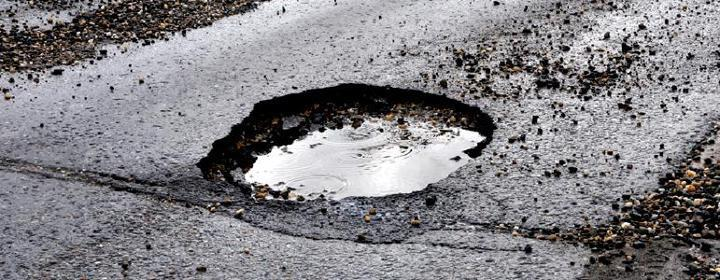

In [10]:
Image(filename='pothole/train/images/img-479_jpg.rf.68af46ff65675c6673f7ab2b3ffffef5.jpg',
      width=500)

In [25]:
import glob

train_img_list = glob.glob('pothole/train/images/*.jpg')
val_img_list = glob.glob('pothole/valid/images/*.jpg')
test_img_list = glob.glob('pothole/test/images/*.jpg')

In [16]:
len(train_img_list), len(val_img_list), len(test_img_list)

(465, 133, 67)

In [18]:
ls -al pothole

total 12
drwx------ 4 root root 4096 Dec  7 07:50 test/
drwx------ 4 root root 4096 Dec  7 07:50 train/
drwx------ 4 root root 4096 Nov  1  2020 valid/


In [26]:
import numpy as np
max_len = len(train_img_list)
val_img_list +=[np.nan]* (max_len - len(val_img_list))
test_img_list +=[np.nan]* (max_len - len(test_img_list))

In [28]:
import pandas as pd
data = {'train':train_img_list, 'val':val_img_list, 'test':test_img_list}
df = pd.DataFrame(data=data)
df

,train,val,test
0,pothole/train/images/img-134_jpg.rf.833f57b2c5...,pothole/valid/images/img-153_jpg.rf.ba410ca055...,pothole/test/images/img-394_jpg.rf.2182e193f33...
1,pothole/train/images/img-424_jpg.rf.5178a699e9...,pothole/valid/images/img-596_jpg.rf.9b1ad14e14...,pothole/test/images/img-440_jpg.rf.4475e2f277c...
2,pothole/train/images/img-250_jpg.rf.7632980b59...,pothole/valid/images/img-369_jpg.rf.14cb906802...,pothole/test/images/img-576_jpg.rf.f6cd32a51b0...
3,pothole/train/images/img-331_jpg.rf.7e9a426652...,pothole/valid/images/img-244_jpg.rf.c05e5207f5...,pothole/test/images/img-590_jpg.rf.7ee475f30ca...
4,pothole/train/images/img-11_jpg.rf.b7a2e18571a...,pothole/valid/images/img-490_jpg.rf.32377cf7b8...,pothole/test/images/img-161_jpg.rf.211541e7178...
...,...,...,...
460,pothole/train/images/img-54_jpg.rf.f2eb8e6eddf...,NaN,NaN
461,pothole/train/images/img-584_jpg.rf.fc44d8fdba...,NaN,NaN
462,pothole/train/images/img-9_jpg.rf.de0e0920eee9...,NaN,NaN
463,pothole/train/images/img-81_jpg.rf.3cde6b9acba...,NaN,NaN


In [19]:
import yaml

with open('pothole/train.txt', 'w') as f:
    f.write('\n'.join(train_img_list) + '\n')
with open('pothole/val.txt', 'w') as f:
    f.write('\n'.join(val_img_list) + '\n')
with open('pothole/test.txt', 'w') as f:
    f.write('\n'.join(test_img_list) + '\n')

In [20]:
ls -al pothole

total 60
drwx------ 4 root root  4096 Dec  7 07:50 test/
-rw------- 1 root root  4812 Dec  8 04:42 test.txt
drwx------ 4 root root  4096 Dec  7 07:50 train/
-rw------- 1 root root 33878 Dec  8 04:42 train.txt
drwx------ 4 root root  4096 Nov  1  2020 valid/
-rw------- 1 root root  9680 Dec  8 04:42 val.txt


In [29]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def write_template(file, txts):
    with open(file, 'w') as f:
        f.write(txts.format(**globals()))

In [34]:
!cat pothole/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['pothole']

# 이미지 파일 위치 설정

In [35]:
%%write_template pothole/data.yaml

train: ./pothole/train/images
val: ./pothole/valid/images
test: ./pothole/test/images

nc: 1
names: ['pothole']

In [36]:
!cat pothole/data.yaml


train: ./pothole/train/images
val: ./pothole/valid/images
test: ./pothole/test/images

nc: 1
names: ['pothole']


# 기존 Model layer 확인 및 아웃풋 classes 변수로

In [46]:
import yaml

with open('./pothole/data.yaml', 'r') as f:
    num_cls = str(yaml.safe_load(f)['nc'])
    # num_cls -> nc: 1

!cat models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, AGPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]

In [47]:
!ls models

common.py	 hub	      segment  yolo.py	     yolov5m.yaml  yolov5s.yaml
experimental.py  __init__.py  tf.py    yolov5l.yaml  yolov5n.yaml  yolov5x.yaml


In [51]:
num_cls

'1'

# 학습 방법의 model layers

In [59]:
%%write_template ./models/custom_yolov5s.yaml

# Parameters
nc: {num_cls}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [60]:
!cat ./models/custom_yolov5s.yaml


# Parameters
nc: 1  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

# training

In [54]:
ls -al

total 340
-rw------- 1 root root  8009 Dec  7 07:31 benchmarks.py
-rw------- 1 root root   393 Dec  7 07:31 CITATION.cff
drwx------ 2 root root  4096 Dec  7 07:31 classify/
-rw------- 1 root root  5009 Dec  7 07:31 CONTRIBUTING.md
drwx------ 2 root root  4096 Dec  7 07:31 data/
-rw------- 1 root root 15364 Dec  7 07:31 detect.py
-rw------- 1 root root  3701 Dec  7 07:31 .dockerignore
-rw------- 1 root root 41275 Dec  7 07:31 export.py
drwx------ 2 root root  4096 Dec  7 07:31 .git/
-rw------- 1 root root    75 Dec  7 07:31 .gitattributes
drwx------ 2 root root  4096 Dec  7 07:31 .github/
-rw------- 1 root root  3998 Dec  7 07:31 .gitignore
-rw------- 1 root root  7769 Dec  7 07:31 hubconf.py
drwx------ 2 root root  4096 Dec  7 07:52 .ipynb_checkpoints/
-rw------- 1 root root 34523 Dec  7 07:31 LICENSE
drwx------ 4 root root  4096 Dec  8 05:12 models/
drwx------ 5 root root  4096 Dec  8 04:56 pothole/
-rw------- 1 root root  1815 Dec  7 07:31 .pre-commit-config.yaml
-rw------- 1 root ro

In [55]:
cat ./pothole/data.yaml


train: ./pothole/train/images
val: ./pothole/valid/images
test: ./pothole/test/images

nc: 1
names: ['pothole']


* `img`: 입력 이미지 크기 정의
* `batch`: 배치 크기 결정
* `epochs`: 학습 기간 개수 정의
* `data`: 학습할 img 경로 yaml 파일
* `cfg`: 학습할 방법의 model layers
* `weights`: 가중치에 대한 경로 지정
* `name`: 학습 결과할 파일 이름
* `nosave`: 최종 체크포인트만 저장
* `cache`: 빠른 학습을 위한 이미지 캐시

In [61]:
!python train.py --img 640 --batch 32 --epochs 50 \
--data ./pothole/data.yaml --cfg ./models/custom_yolov5s.yaml \
--weight '' --name pothole_results --cache

2023-12-08 05:38:34.718330: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-08 05:38:34.718389: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-08 05:38:34.718424: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=, cfg=./models/custom_yolov5s.yaml, data=./pothole/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=F

# 결과 확인

In [70]:
# 학습을 시작하니 runs 파일 자동 생성.
ls runs/train/pothole_results2

confusion_matrix.png                                 PR_curve.png           val_batch0_pred.jpg
events.out.tfevents.1702013917.94bc4a7f43d2.17672.0  R_curve.png            val_batch1_labels.jpg
F1_curve.png                                         results.csv            val_batch1_pred.jpg
hyp.yaml                                             results.png            val_batch2_labels.jpg
labels_correlogram.jpg                               train_batch0.jpg       val_batch2_pred.jpg
labels.jpg                                           train_batch1.jpg       weights/
opt.yaml                                             train_batch2.jpg
P_curve.png                                          val_batch0_labels.jpg


In [72]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [73]:
ls ./runs/train/pothole_results2

confusion_matrix.png                                 PR_curve.png           val_batch0_pred.jpg
events.out.tfevents.1702013917.94bc4a7f43d2.17672.0  R_curve.png            val_batch1_labels.jpg
F1_curve.png                                         results.csv            val_batch1_pred.jpg
hyp.yaml                                             results.png            val_batch2_labels.jpg
labels_correlogram.jpg                               train_batch0.jpg       val_batch2_pred.jpg
labels.jpg                                           train_batch1.jpg       weights/
opt.yaml                                             train_batch2.jpg
P_curve.png                                          val_batch0_labels.jpg


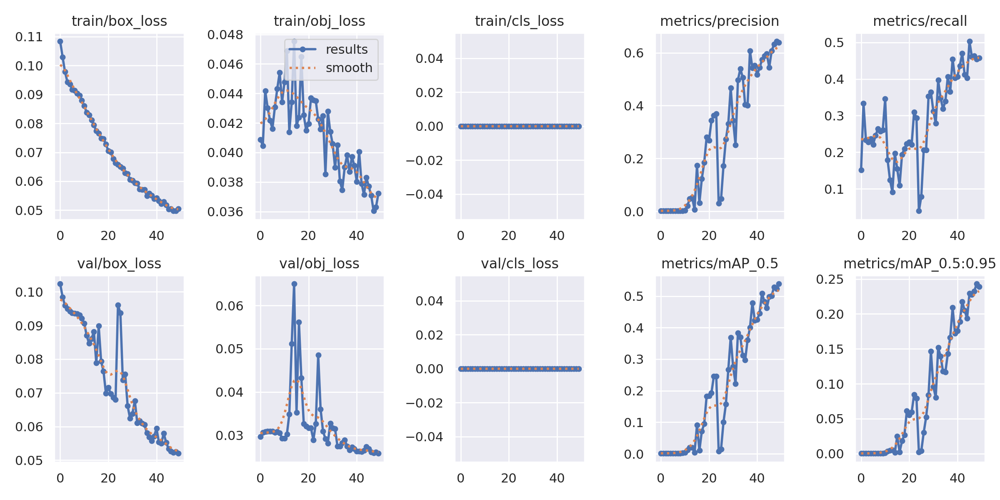

In [74]:
from IPython.display import Image
Image(filename='./runs/train/pothole_results2/results.png', width=600)

In [75]:
pd.read_csv('./runs/train/pothole_results2/results.csv')

,epoch,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,metrics/recall,metrics/mAP_0.5,metrics/mAP_0.5:0.95,val/box_loss,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
0,0,0.108390,0.040887,0,0.001667,0.151520,0.001037,0.000290,0.102400,0.029670,0,0.087400,0.001400,0.001400
1,1,0.102960,0.040443,0,0.002757,0.333330,0.001969,0.000510,0.098467,0.030686,0,0.073843,0.002843,0.002843
2,2,0.097828,0.044182,0,0.001930,0.233330,0.001515,0.000365,0.095946,0.030811,0,0.060226,0.004226,0.004226
3,3,0.094323,0.043030,0,0.001880,0.227270,0.001477,0.000369,0.094932,0.030942,0,0.046550,0.005549,0.005549
4,4,0.093559,0.042168,0,0.001955,0.236360,0.001501,0.000367,0.094280,0.030955,0,0.032814,0.006814,0.006814
5,5,0.091742,0.041621,0,0.001830,0.221210,0.001364,0.000356,0.093773,0.030944,0,0.019019,0.008019,0.008019
6,6,0.091410,0.043064,0,0.002030,0.245450,0.001553,0.000404,0.093562,0.030679,0,0.008812,0.008812,0.008812
7,7,0.090406,0.044318,0,0.002181,0.263640,0.001866,0.000447,0.093548,0.030865,0,0.008812,0.008812,0.008812
8,8,0.089732,0.045421,0,0.002130,0.257580,0.001625,0.000423,0.093174,0.030596,0,0.008614,0.008614,0.008614
9,9,0.087921,0.043428,0,0.002155,0.260610,0.002208,0.000682,0.092104,0.029317,0,0.008416,0.008416,0.008416


In [77]:
ls runs/train/pothole_results2

confusion_matrix.png                                 PR_curve.png           val_batch0_pred.jpg
events.out.tfevents.1702013917.94bc4a7f43d2.17672.0  R_curve.png            val_batch1_labels.jpg
F1_curve.png                                         results.csv            val_batch1_pred.jpg
hyp.yaml                                             results.png            val_batch2_labels.jpg
labels_correlogram.jpg                               train_batch0.jpg       val_batch2_pred.jpg
labels.jpg                                           train_batch1.jpg       weights/
opt.yaml                                             train_batch2.jpg
P_curve.png                                          val_batch0_labels.jpg


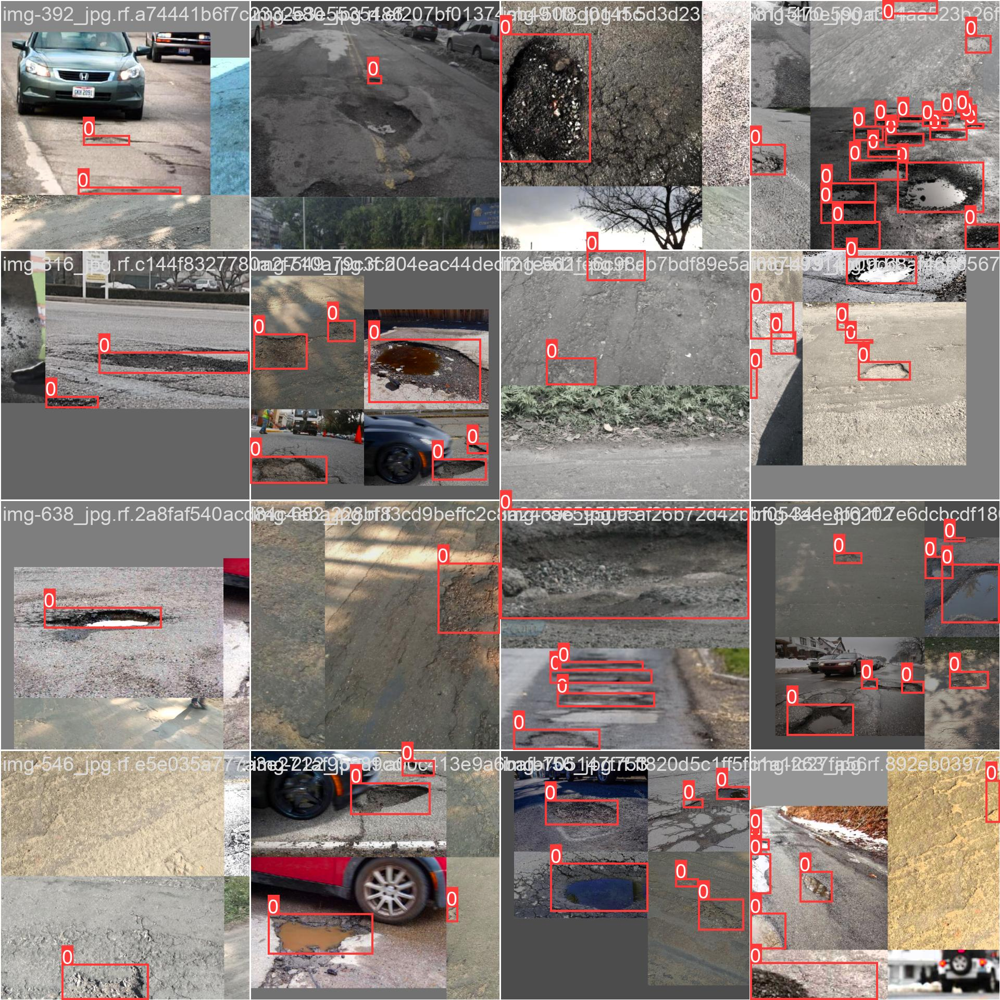

In [78]:
Image(filename='runs/train/pothole_results2/train_batch0.jpg')

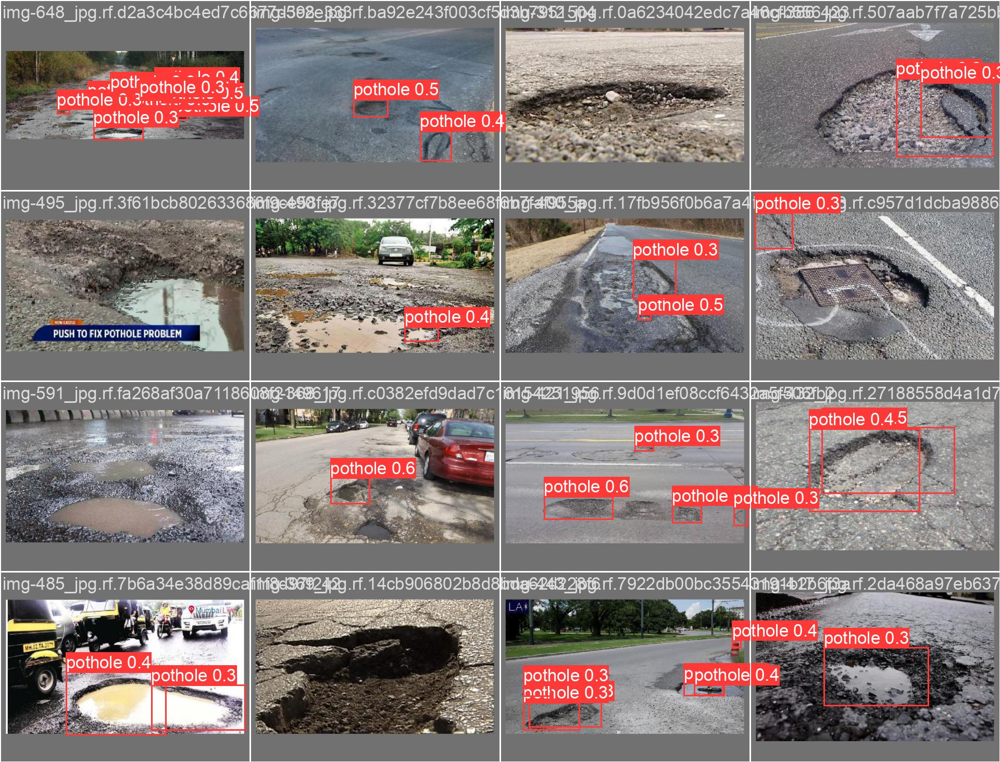

In [79]:
Image(filename='runs/train/pothole_results2/val_batch0_pred.jpg')

# 검증

In [80]:
ls

benchmarks.py    data/       LICENSE       README.dataset.txt   requirements.txt  train.py
CITATION.cff     detect.py   models/       README.md            runs/             tutorial.ipynb
classify/        export.py   pothole/      README.roboflow.txt  segment/          utils/
CONTRIBUTING.md  hubconf.py  __pycache__/  README.zh-CN.md      setup.cfg         val.py


In [82]:
ls runs/train/pothole_results2/weights

best.pt  last.pt


In [83]:
!python val.py --weight runs/train/pothole_results2/weights/best.pt \
--data ./pothole/data.yaml --img 640 --iou 0.65 --half

val: data=./pothole/data.yaml, weights=['runs/train/pothole_results2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/contents/MyDrive/working/yolov5/pothole/valid/labels.cache... 133 images, 0 backgrounds, 0 corrupt: 100% 133/133 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 5/5 [00:05<00:00,  1.10s/it]
                   all        133        330      0.607      0.448      0.507      0.241
Speed: 0.2ms pre-process, 17.8ms inference, 5.8ms NMS per image at shape 

In [87]:
ls runs/val/exp

confusion_matrix.png  PR_curve.png           val_batch0_pred.jpg    val_batch2_labels.jpg
F1_curve.png          R_curve.png            val_batch1_labels.jpg  val_batch2_pred.jpg
P_curve.png           val_batch0_labels.jpg  val_batch1_pred.jpg


In [ ]:
# %load_ext tensorboard

In [91]:
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 25967), started 0:14:50 ago. (Use '!kill 25967' to kill it.)

<IPython.core.display.Javascript object>

In [92]:
!python val.py --weight runs/train/pothole_results2/weights/best.pt \
--data ./pothole/data.yaml --img 640 --task test

val: data=./pothole/data.yaml, weights=['runs/train/pothole_results2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/contents/MyDrive/working/yolov5/pothole/test/labels... 67 images, 0 backgrounds, 0 corrupt: 100% 67/67 [00:54<00:00,  1.23it/s]
test: New cache created: /content/contents/MyDrive/working/yolov5/pothole/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 3/3 [00:05<00:00,  1.83s/it]
                   all         67        154      0.564      0.461    

# 추론

In [93]:
ls

benchmarks.py    data/       LICENSE       README.dataset.txt   requirements.txt  train.py
CITATION.cff     detect.py   models/       README.md            runs/             tutorial.ipynb
classify/        export.py   pothole/      README.roboflow.txt  segment/          utils/
CONTRIBUTING.md  hubconf.py  __pycache__/  README.zh-CN.md      setup.cfg         val.py


In [94]:
!python detect.py --weight runs/train/pothole_results2/weights/best.pt \
--img 640 --conf 0.4 --source ./pothole/test/images

detect: weights=['runs/train/pothole_results2/weights/best.pt'], source=./pothole/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/67 /content/contents/MyDrive/working/yolov5/pothole/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg: 640x640 (no detections), 11.5ms
image 2/67 /content/contents/MyDrive/working/yolov5/pothole/test/images/img-107_jpg.rf.2e40485785f6e5e2efec404301b235c2.jpg: 640x640 1 pothole, 11.5ms

In [98]:
ls runs

detect/  train/  val/


In [97]:
loc_imgs=glob.glob('./runs/detect/exp/*.jpg')

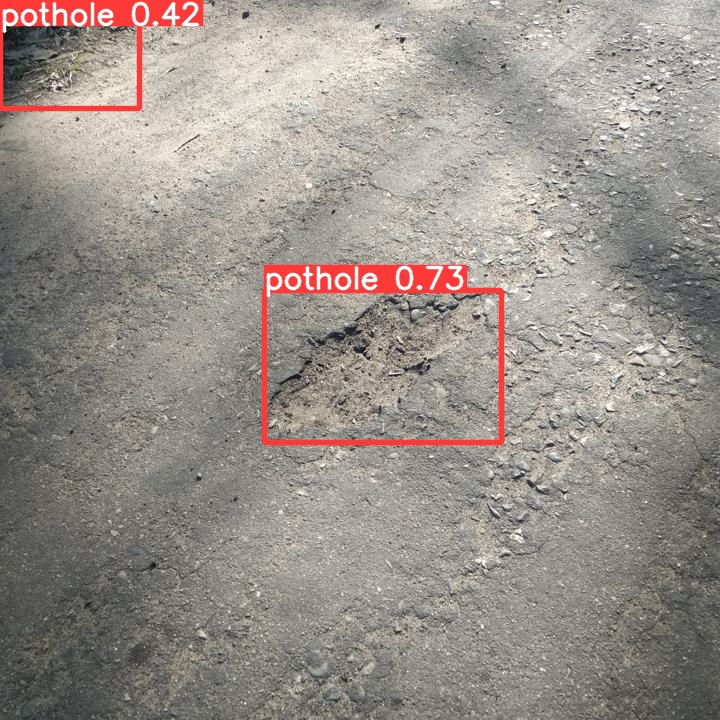

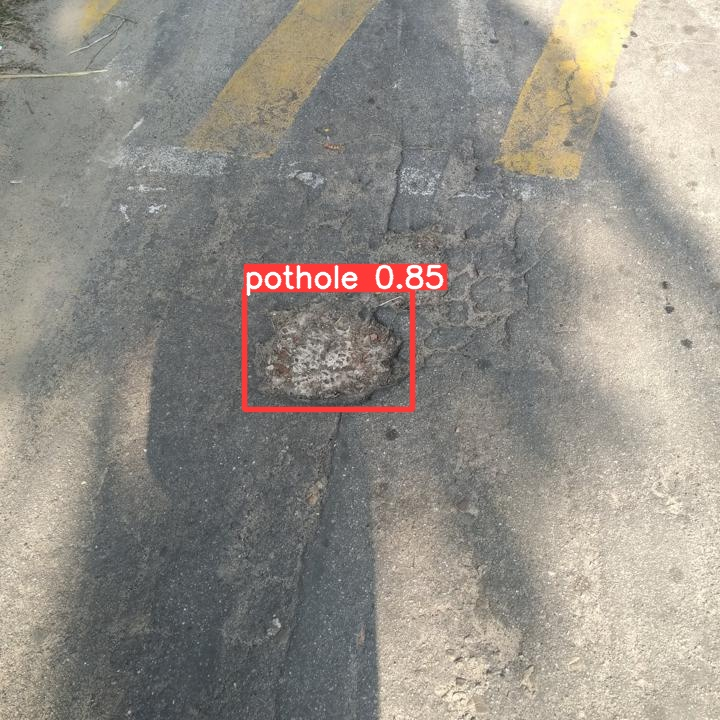

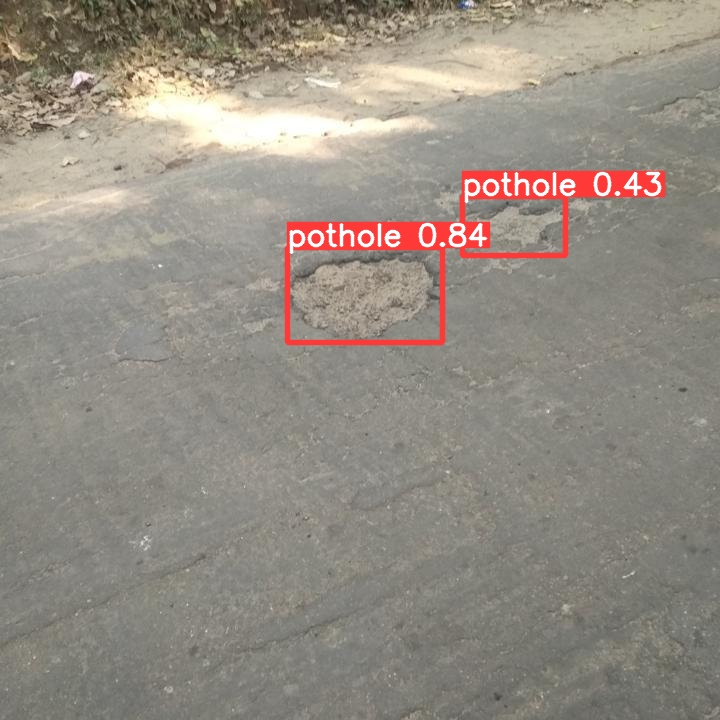

In [102]:
import glob
import random
from IPython.display import Image, display

for _ in range(3):
    img = random.choice(loc_imgs)
    display(Image(filename=img, width=600))

In [105]:
!cp runs/train/pothole_results2/weights/best.pt pothole

In [106]:
ls pothole

best.pt  data.yaml  test/  test.txt  train/  train.txt  valid/  val.txt


# wildfire smoke

In [107]:
!mkdir smoke

In [108]:
cd smoke

/content/contents/MyDrive/working/yolov5/smoke


In [110]:
!curl -L "https://public.roboflow.com/ds/tOwyWOQmMh?key=2GMgyTa6rx" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2355      0 --:--:-- --:--:-- --:--:--  2358
100 27.6M  100 27.6M    0     0  25.2M      0  0:00:01  0:00:01 --:--:-- 46.8M
Archive:  roboflow.zip
 extracting: test/images/ck0rqdyeq4kxa08633xv2wqe1_jpeg.rf.30df6babe258cdc1d5a4e042262665e4.jpg  
 extracting: test/images/ck0qd918zic840701hnezgpgy_jpeg.rf.30de65aa3639b8a113db71a11bc2726c.jpg  
 extracting: test/images/ck0kfjen48qhj0701wjkosmel_jpeg.rf.49b365cc7135deee1332e6657401abc5.jpg  
 extracting: test/images/ck0t7cczuqxtt07212nj5eznh_jpeg.rf.1a9299c8658d89f6271dba2aeefe074d.jpg  
 extracting: test/images/ck0kn8y5y9y3507018k5p06ma_jpeg.rf.466b2fb63a73c0138cf75b3ddc71d490.jpg  
 extracting: test/images/ck0tzjni6sjt50863e6a6a8fl_jpeg.rf.46d343d22cd08c90668cc0d50bc52a2d.jpg  
 extracting: test/images/ck0tszlepw02k0721zr71djfj_jpeg.rf.2c8ed6a3dc364f

In [111]:
import torch
from IPython.display import Image

In [112]:
ls

data.yaml  README.dataset.txt  README.roboflow.txt  test/  train/  valid/


In [113]:
!cat data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['smoke']

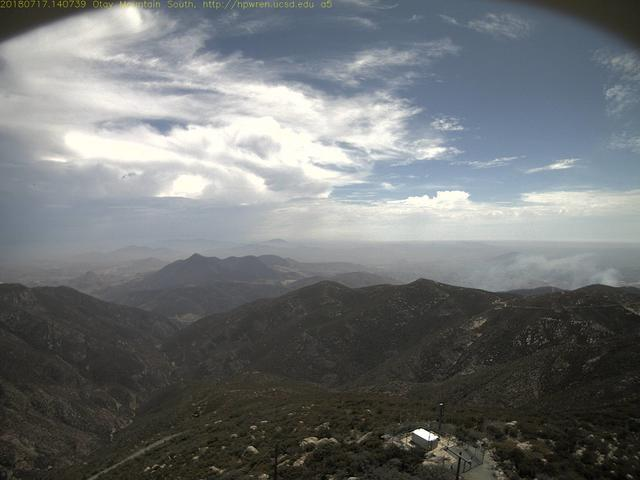

In [116]:
Image(filename='train/images/ck0u02mwv6bah0a467209caub_jpeg.rf.4946e8ee4a4af8ff2dddd94c59d3d2ef.jpg', width=600)

In [118]:
!cat train/labels/ck0tyfppk6qqc0848u6xtpzgx_jpeg.rf.288099a51913c76a030ce91555ac3929.txt

0 0.65 0.3770833333333333 0.325 0.32083333333333336

In [121]:
cd ..

/content/contents/MyDrive/working/yolov5


In [125]:
import glob
train_smoke_imgs = glob.glob('./smoke/train/images/*.jpg')
val_smoke_imgs = glob.glob('./smoke/valid/images/*.jpg')
test_smoke_imgs = glob.glob('./smoke/test/images/*.jpg')

print(len(train_smoke_imgs), len(val_smoke_imgs), len(test_smoke_imgs))

516 147 74


In [122]:
ls smoke/train/images/

ck0k99e6p79go0944lmxivkmv_jpeg.rf.035851b1218826a8d8e1f6cff055da7a.jpg
ck0k99r7bir3f0a460bctrlmy_jpeg.rf.0520c5989e9d6326d3beb346e7edc7c2.jpg
ck0k9dg0vjxcg0848rmqzl38w_jpeg.rf.aa2243c64fd18ad4e8c179d09c12cbfc.jpg
ck0k9etuqjxhh0848k6i1mw2f_jpeg.rf.65e16bd6d3135e530e8e7677b83b6481.jpg
ck0k9ghqt7a8l0944mcvy0jsx_jpeg.rf.5b55501a403c70b4dba61727046660b5.jpg
ck0k9jss09oxq0721c8pd7eds_jpeg.rf.fa5ce52e0ebc5762bee66acd5bc1aa1d.jpg
ck0kcaec57i7s0944jkpjyecx_jpeg.rf.0dbf4b042f0b6abc7a9f1a42a82a20dd.jpg
ck0kcbvwl4tja0794csyimfqu_jpeg.rf.9b8fccc32c80221a31a78bc6b8c54b39.jpg
ck0kcju199xgd0721ljl6cd2n_jpeg.rf.1b068071c8dfc4cf3573f0a0e217f523.jpg
ck0kck2czj0l10a46f6xkvofl_jpeg.rf.678c741e4261415dc135ecaf38d4581d.jpg
ck0kcljocj0qo0a46rzj3y211_jpeg.rf.5745457a99cce20a1ed09c59819d1d6b.jpg
ck0kcn7u1j0vk0a46lr8si8zl_jpeg.rf.ab05dcea54504926189eaf13d19802ec.jpg
ck0kcnh1p4uns0794bs53wqam_jpeg.rf.1a912c1d8dea7ad3ad9bc870fe7a62d1.jpg
ck0kcouioj11m0a46yjyp0zlc_jpeg.rf.5d515391615546df6369aa216c2fac53.jpg
ck0kcp

In [126]:
ls smoke

data.yaml  README.dataset.txt  README.roboflow.txt  test/  train/  valid/


In [127]:
import yaml

with open('smoke/train.txt', 'w') as f:
    f.write('\n'.join(train_smoke_imgs) + '\n')
with open('smoke/val.txt', 'w') as f:
    f.write('\n'.join(val_smoke_imgs) + '\n')
with open('smoke/test.txt', 'w') as f:
    f.write('\n'.join(test_smoke_imgs) + '\n')

In [128]:
ls smoke

data.yaml           README.roboflow.txt  test.txt  train.txt  val.txt
README.dataset.txt  test/                train/    valid/


In [129]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def write_template(file, txts):
    with open(file, 'w') as f:
        f.write(txts.format(**globals()))

In [130]:
!cat smoke/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['smoke']

In [134]:
%%write_template smoke/data.yaml

train: ./smoke/train/images
val: ./smoke/valid/images
test: ./smoke/test/images

nc: 1
names: ['smoke']

In [135]:
!cat smoke/data.yaml


train: ./smoke/train/images
val: ./smoke/valid/images
test: ./smoke/test/images

nc: 1
names: ['smoke']


In [136]:
import yaml

with open('./smoke/data.yaml', 'r') as f:
    num_cls = str(yaml.safe_load(f)['nc'])
    # num_cls -> nc: 1

!cat models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, AGPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]

In [137]:
%%write_template ./models/smoke_yolov5s.yaml

# Parameters
nc: {num_cls}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

In [138]:
!cat models/smoke_yolov5s.yaml


# Parameters
nc: 1  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

In [139]:
!cat smoke/data.yaml


train: ./smoke/train/images
val: ./smoke/valid/images
test: ./smoke/test/images

nc: 1
names: ['smoke']


In [140]:
!python train.py --img 640 --batch 32 --epochs 50 \
--data ./smoke/data.yaml --cfg ./models/smoke_yolov5s.yaml \
--weight '' --name smoke_results --cache

2023-12-08 07:30:14.927127: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-08 07:30:14.927196: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-08 07:30:14.927239: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=, cfg=./models/smoke_yolov5s.yaml, data=./smoke/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=Fals

In [141]:
ls runs/train/smoke_results

confusion_matrix.png                                 PR_curve.png           val_batch0_pred.jpg
events.out.tfevents.1702020617.94bc4a7f43d2.47690.0  R_curve.png            val_batch1_labels.jpg
F1_curve.png                                         results.csv            val_batch1_pred.jpg
hyp.yaml                                             results.png            val_batch2_labels.jpg
labels_correlogram.jpg                               train_batch0.jpg       val_batch2_pred.jpg
labels.jpg                                           train_batch1.jpg       weights/
opt.yaml                                             train_batch2.jpg
P_curve.png                                          val_batch0_labels.jpg


In [145]:
%reload_ext tensorboard
%tensorboard --logdir runs

Reusing TensorBoard on port 6006 (pid 25967), started 1:36:00 ago. (Use '!kill 25967' to kill it.)

<IPython.core.display.Javascript object>

In [146]:
ls runs/train/smoke_results

confusion_matrix.png                                 PR_curve.png           val_batch0_pred.jpg
events.out.tfevents.1702020617.94bc4a7f43d2.47690.0  R_curve.png            val_batch1_labels.jpg
F1_curve.png                                         results.csv            val_batch1_pred.jpg
hyp.yaml                                             results.png            val_batch2_labels.jpg
labels_correlogram.jpg                               train_batch0.jpg       val_batch2_pred.jpg
labels.jpg                                           train_batch1.jpg       weights/
opt.yaml                                             train_batch2.jpg
P_curve.png                                          val_batch0_labels.jpg


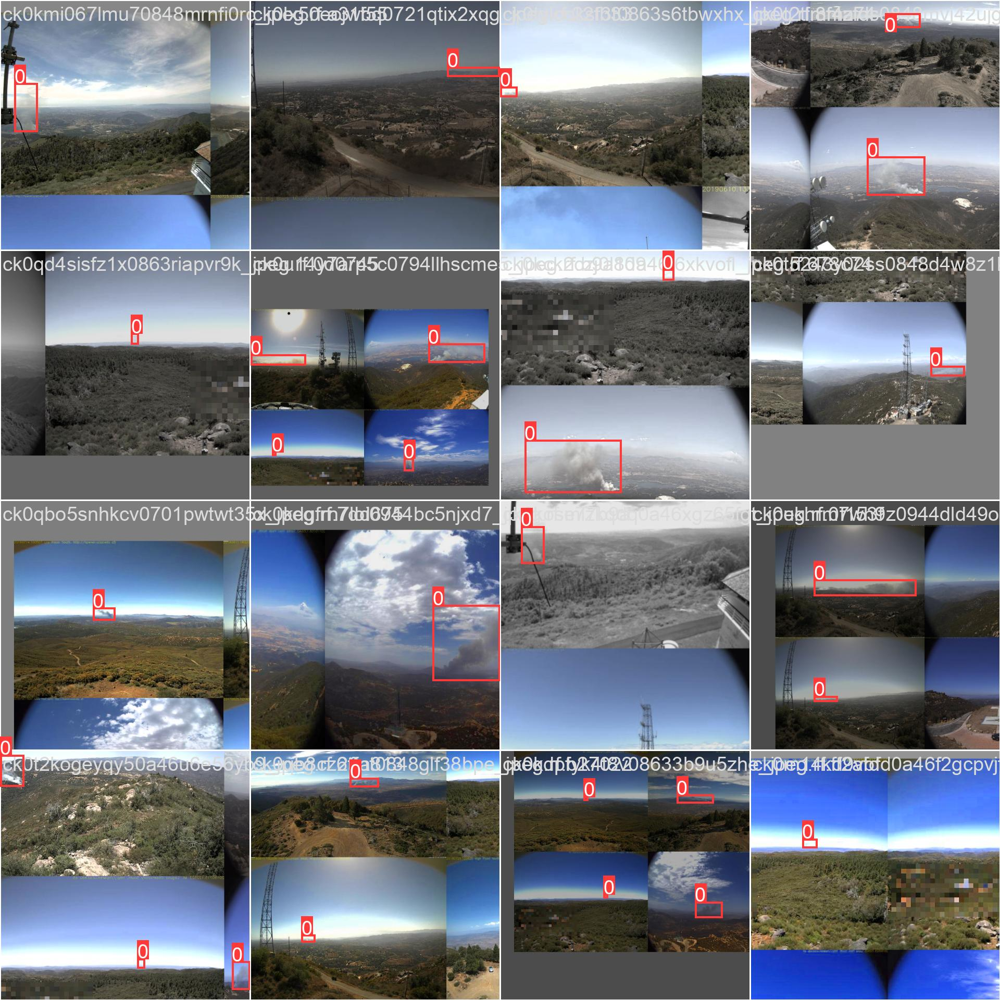

In [149]:
from IPython.display import Image, display
# class
Image(filename='runs/train/smoke_results/train_batch0.jpg')

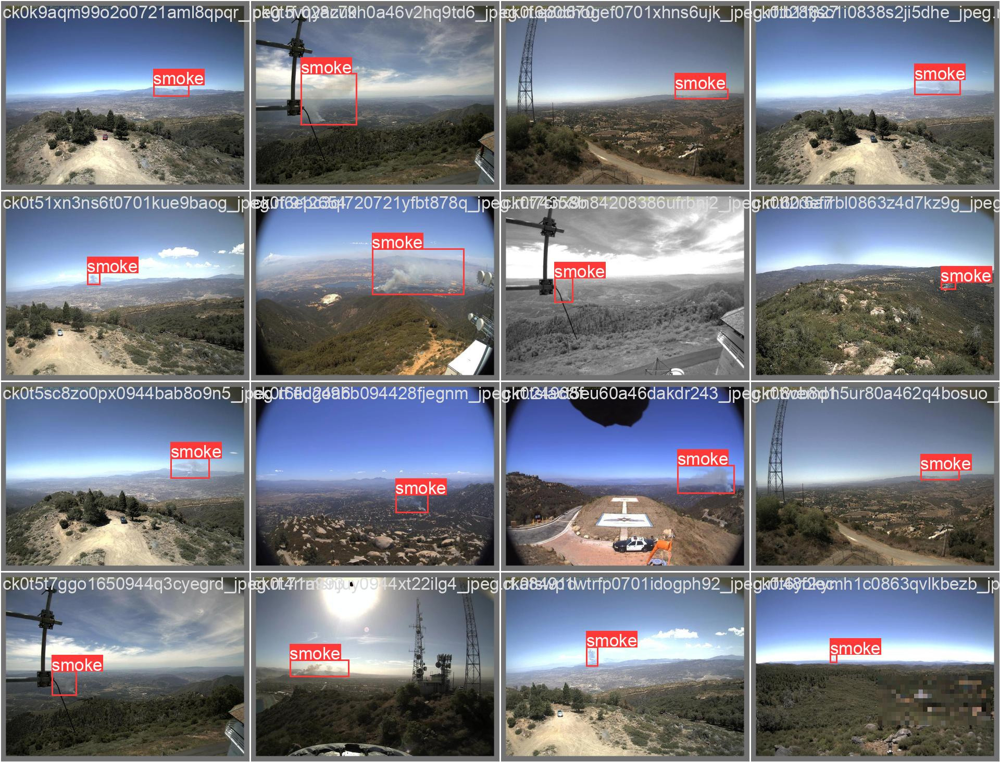

In [150]:
# label
Image(filename='runs/train/smoke_results/val_batch0_labels.jpg')

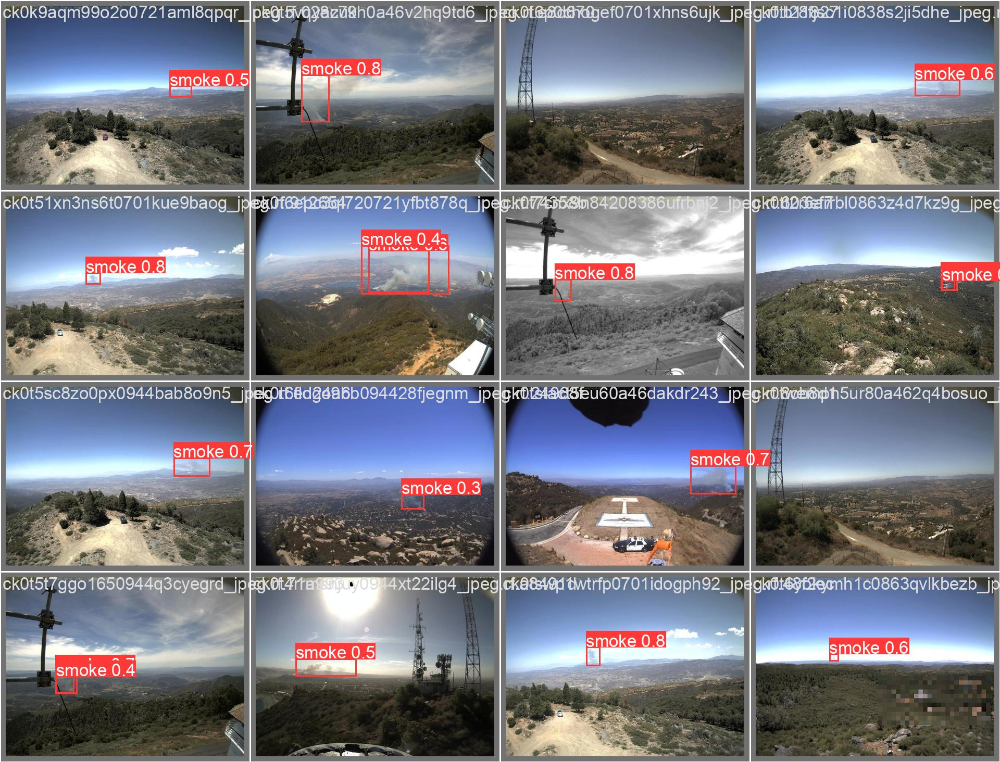

In [151]:
# precision + label
Image(filename='runs/train/smoke_results/val_batch0_pred.jpg')

# 검증

In [153]:
ls runs/train/smoke_results/weights

best.pt  last.pt


In [154]:
!python val.py --weight runs/train/smoke_results/weights/best.pt \
--data ./smoke/data.yaml --img 640 --iou 0.65 --half

val: data=./smoke/data.yaml, weights=['runs/train/smoke_results/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
smoke_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/contents/MyDrive/working/yolov5/smoke/valid/labels.cache... 147 images, 0 backgrounds, 0 corrupt: 100% 147/147 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 5/5 [00:04<00:00,  1.19it/s]
                   all        147        147      0.804       0.67      0.775      0.325
Speed: 0.2ms pre-process, 7.9ms inference, 2.9ms NMS per image at shape (32, 3, 6

In [155]:
!python val.py --weight runs/train/smoke_results/weights/best.pt \
--data ./smoke/data.yaml --img 640 --task test

val: data=./smoke/data.yaml, weights=['runs/train/smoke_results/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
smoke_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/contents/MyDrive/working/yolov5/smoke/test/labels... 74 images, 0 backgrounds, 0 corrupt: 100% 74/74 [00:00<00:00, 178.48it/s]
test: New cache created: /content/contents/MyDrive/working/yolov5/smoke/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 3/3 [00:02<00:00,  1.19it/s]
                   all         74         74      0.825      0.797      0.812  

# 추론

In [156]:
!python detect.py --weight runs/train/smoke_results/weights/best.pt \
--img 640 --conf 0.4 --source ./smoke/test/images

detect: weights=['runs/train/smoke_results/weights/best.pt'], source=./smoke/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-247-g3f02fde Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
smoke_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/74 /content/contents/MyDrive/working/yolov5/smoke/test/images/ck0kcoc8ik6ni0848clxs0vif_jpeg.rf.8b4629777ffe1d349cc970ee8af59eac.jpg: 480x640 1 smoke, 71.5ms
image 2/74 /content/contents/MyDrive/working/yolov5/smoke/test/images/ck0kd4afx8g470701watkwxut_jpeg.rf.bb5a1f2c2b04be20c948fd3c5cec33ff.jpg: 480x6

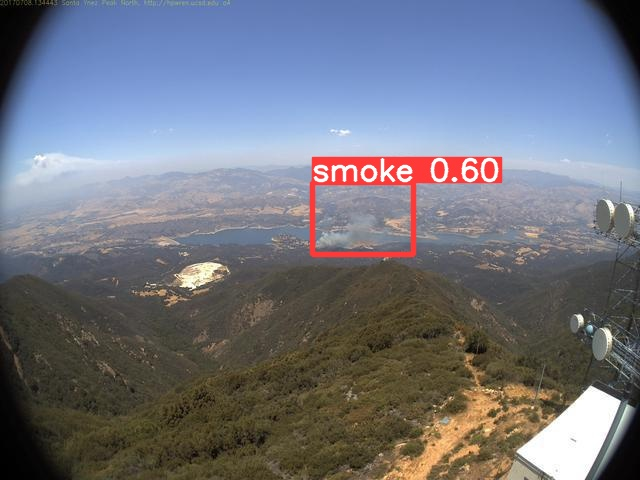

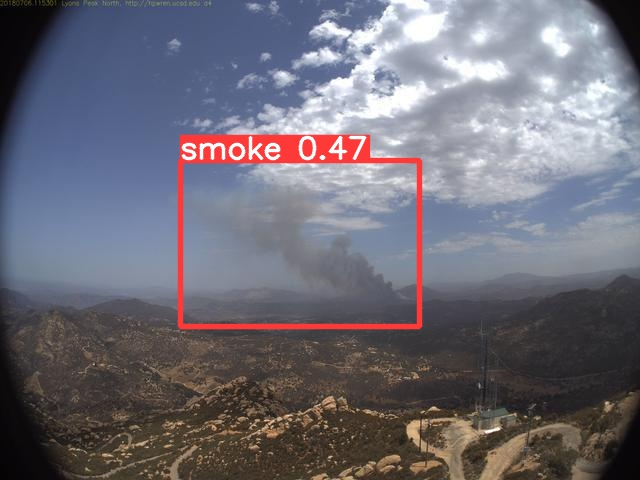

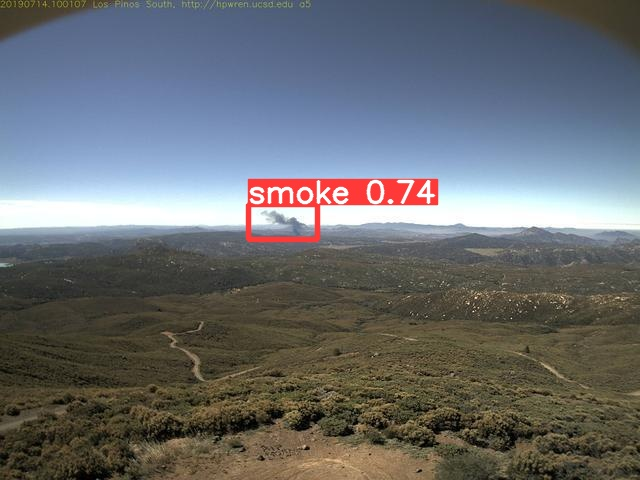

In [161]:
import random
import glob
from IPython.display import Image, display

imgs = glob.glob('runs/detect/exp2/*.jpg')

for _ in range(3):
    img = random.choice(imgs)
    display(Image(filename=img, width=600))

In [162]:
ls runs/train/smoke_results/weights

best.pt  last.pt


In [164]:
ls smoke

data.yaml           README.roboflow.txt  test.txt  train.txt  val.txt
README.dataset.txt  test/                train/    valid/


In [165]:
!mv runs/train/smoke_results/weights/best.pt smoke

In [166]:
ls smoke

best.pt    README.dataset.txt   test/     train/     valid/
data.yaml  README.roboflow.txt  test.txt  train.txt  val.txt
